# Laboratorium 9

Imports

In [244]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps, ImageDraw, ImageFont
import cv2
import textwrap
import string
from collections import defaultdict, namedtuple

In [3]:
def process_img(img, is_rgb = True): 
    gray_image = img.convert('L')
    inverted_image = ImageOps.invert(gray_image)
    return (gray_image, np.swapaxes(np.array(gray_image), 0, 1)) if is_rgb \
        else (inverted_image, np.swapaxes(np.array(inverted_image), 0, 1))

In [4]:
def image_analysis(image_path, pattern_path, max_col_val = 0.5, is_rgb = True):
    image =  Image.open(image_path)
    image_pattern = Image.open(pattern_path)

    w, h = image.size  

    # process image -> change image to gray cmap
    gray_image, processed_img = process_img(image, is_rgb)
    gray_pattern, processed_pattern = process_img(image_pattern, is_rgb)

    dft_image = np.fft.fft2(processed_img)
    shifted_dft_image = np.fft.fftshift(np.fft.fft2(processed_img))
    
    # plot for result

    fig, ax = plt.subplots(3,2,figsize=(20,20))
    fig.tight_layout()

    ax[0,0].imshow(gray_image, cmap='gray')
    ax[0,0].set_title("Processed image")


    ax[0,1].imshow(gray_pattern, cmap='gray')
    ax[0,1].set_title("Processed pattern")

    ax[1,0].imshow(np.swapaxes(np.log(abs(shifted_dft_image)), 0, 1), cmap='gray')
    ax[1,0].set_title("Fourier Transformation of the Image (amplitude) - shifted")

    ax[1,1].imshow(np.swapaxes(np.angle(shifted_dft_image), 0, 1), cmap='gray')
    ax[1,1].set_title("Phase value - shifted")

      
    C = np.real(np.fft.ifft2(np.multiply(dft_image, np.fft.fft2(np.rot90(processed_pattern, 2), s = (w, h)))))
    max_C = np.amax(C)
    new_image = np.array(Image.open(image_path).convert("RGB"))

    occurences = 0

    for i in range(C.shape[0]):
        for j in range(C.shape[1]):
            if C[i, j] >= max_col_val * max_C:
                for k in range(gray_pattern.size[0]):
                    for l in range(gray_pattern.size[1]):
                        new_image[j-k, i-l] = (255, 0, 0)
                occurences += 1
    gs = ax[2, 0].get_gridspec()
    for ax_ in ax[-1, :]:
        ax_.remove()

    axbig = fig.add_subplot(gs[-1, :])
    axbig.imshow(new_image)
    axbig.set_title("Final version - Occurences: {}".format(occurences))

    plt.show()



### Fish

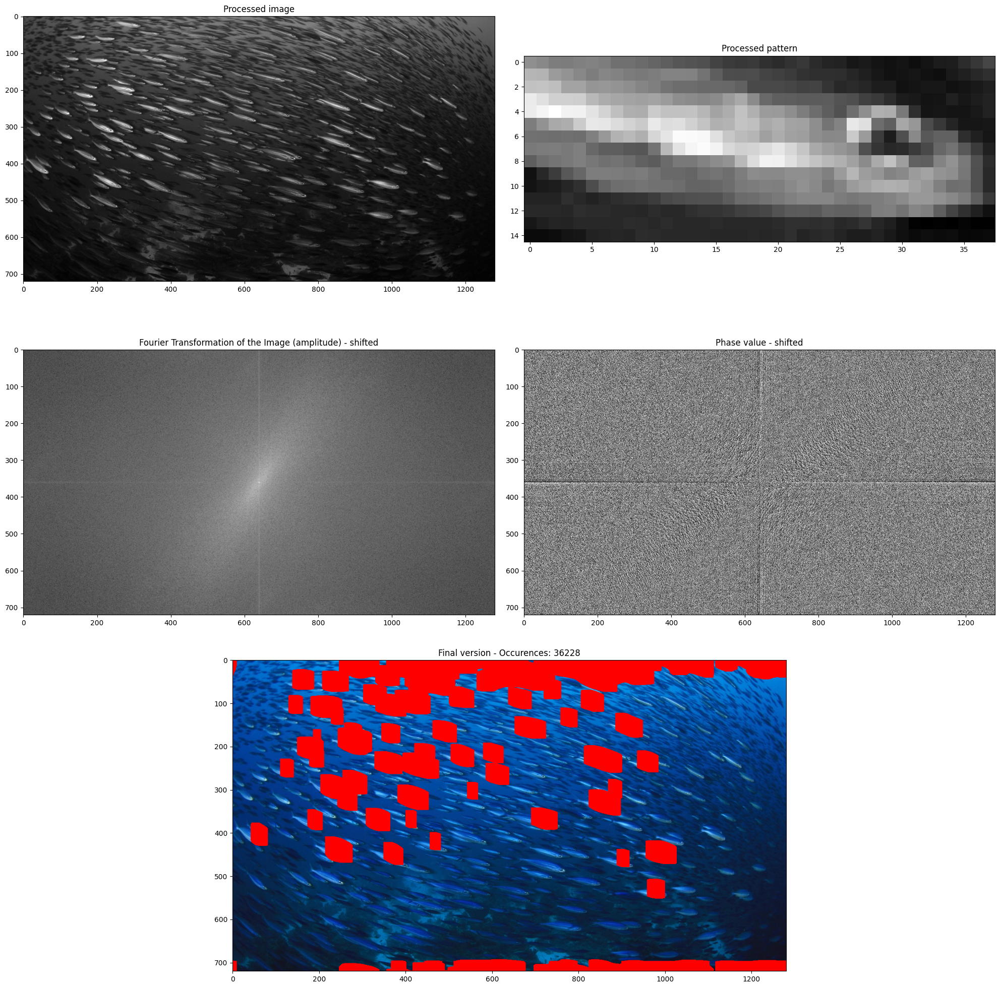

In [5]:
image_analysis("school.jpg", "fish1.png", 0.6)

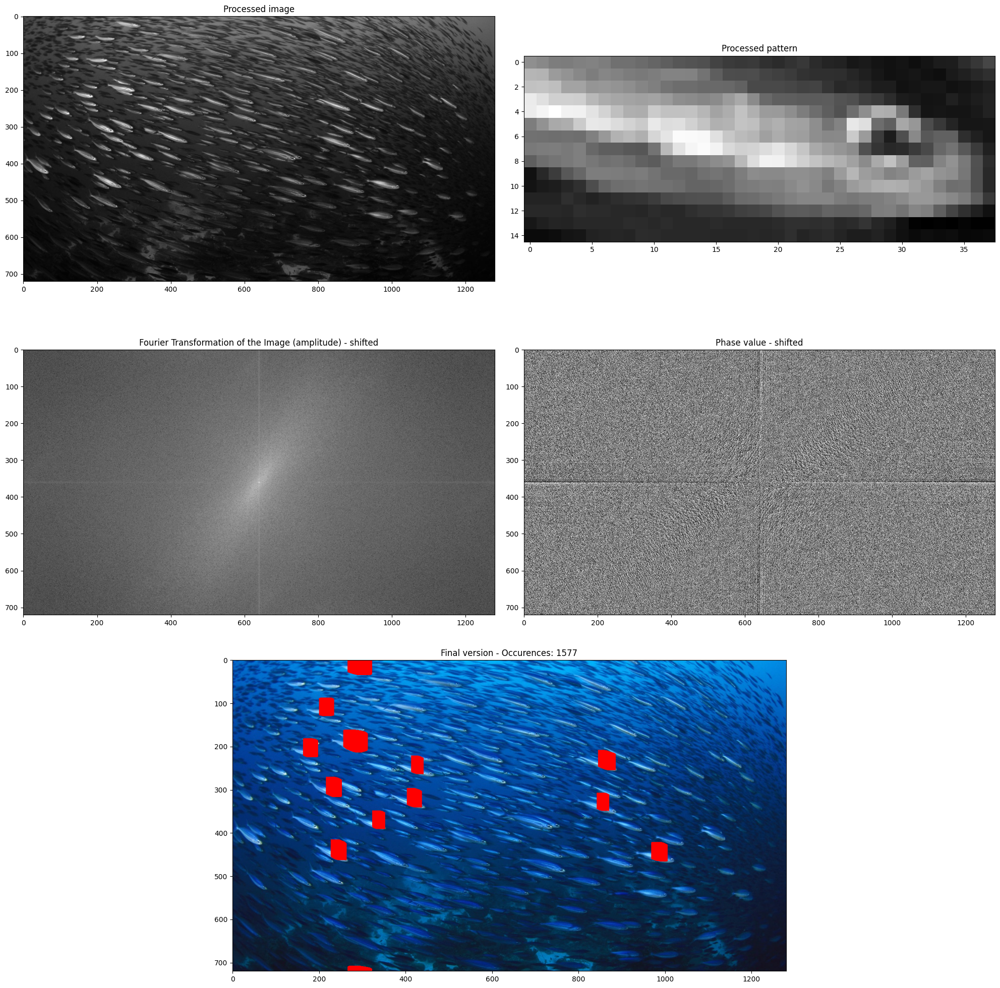

In [6]:
image_analysis("school.jpg", "fish1.png", 0.8)

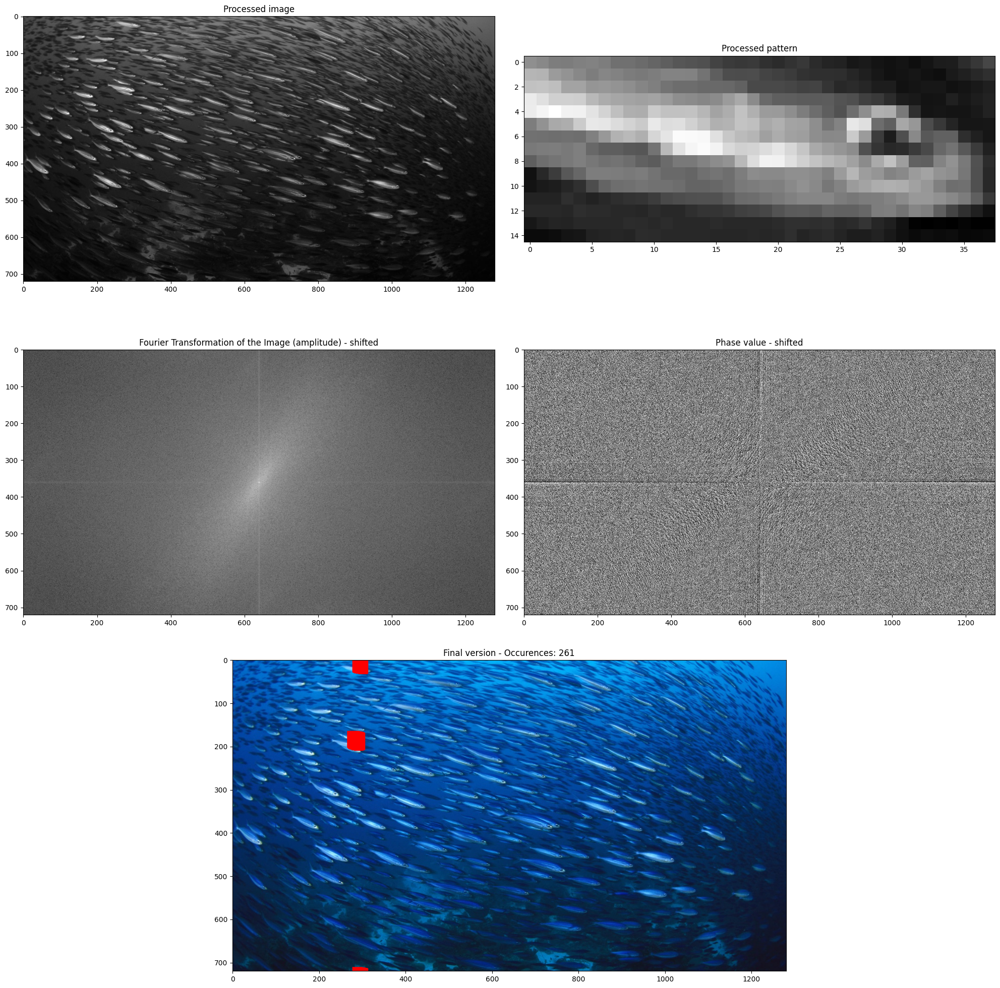

In [7]:
image_analysis("school.jpg", "fish1.png", 0.9)

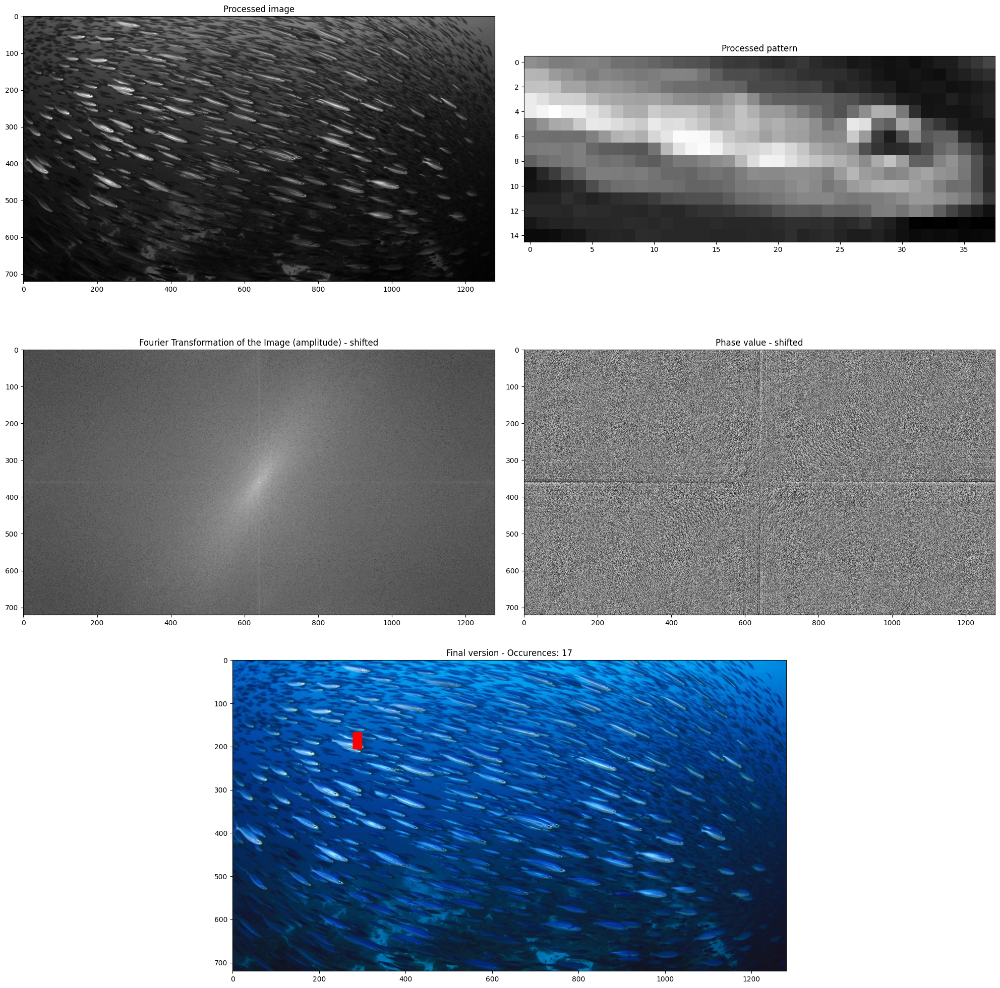

In [9]:
image_analysis("school.jpg", "fish1.png", 0.99)

### Galia

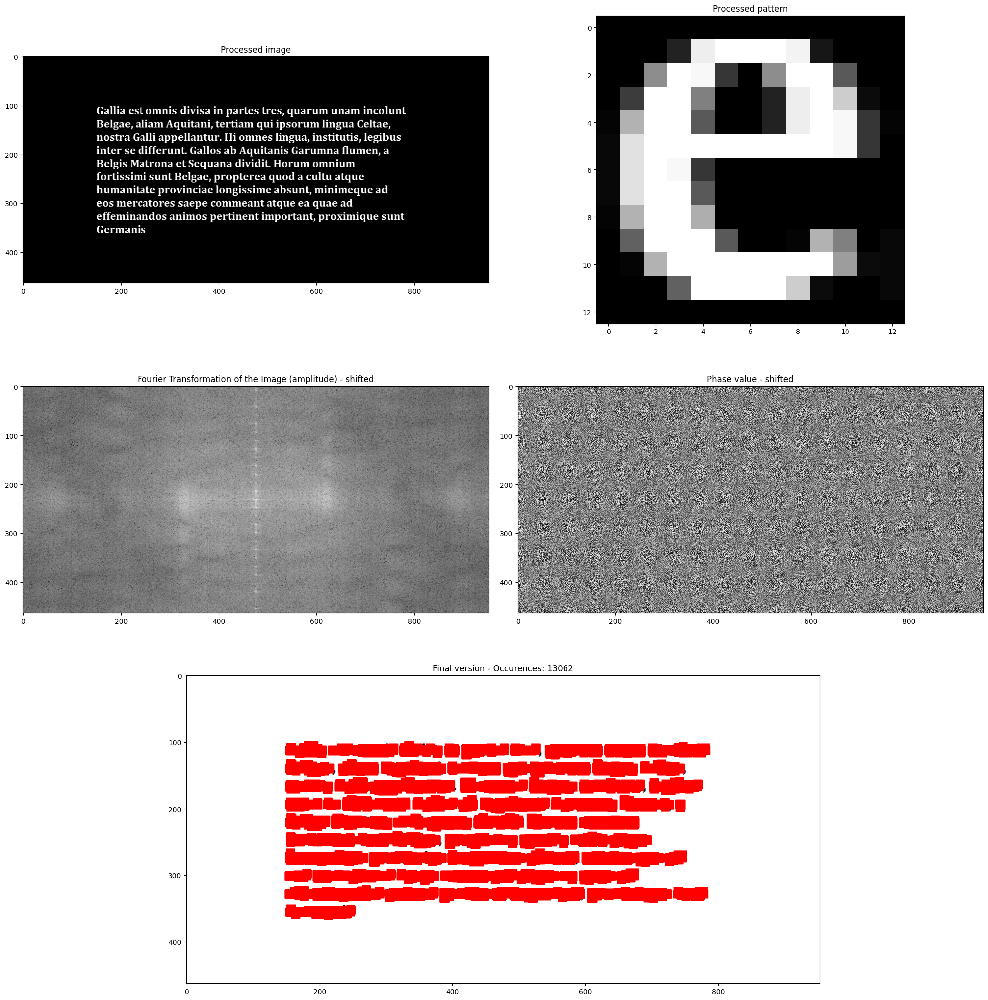

In [10]:
image_analysis("galia.png", "galia_e.png", 0.5, False)

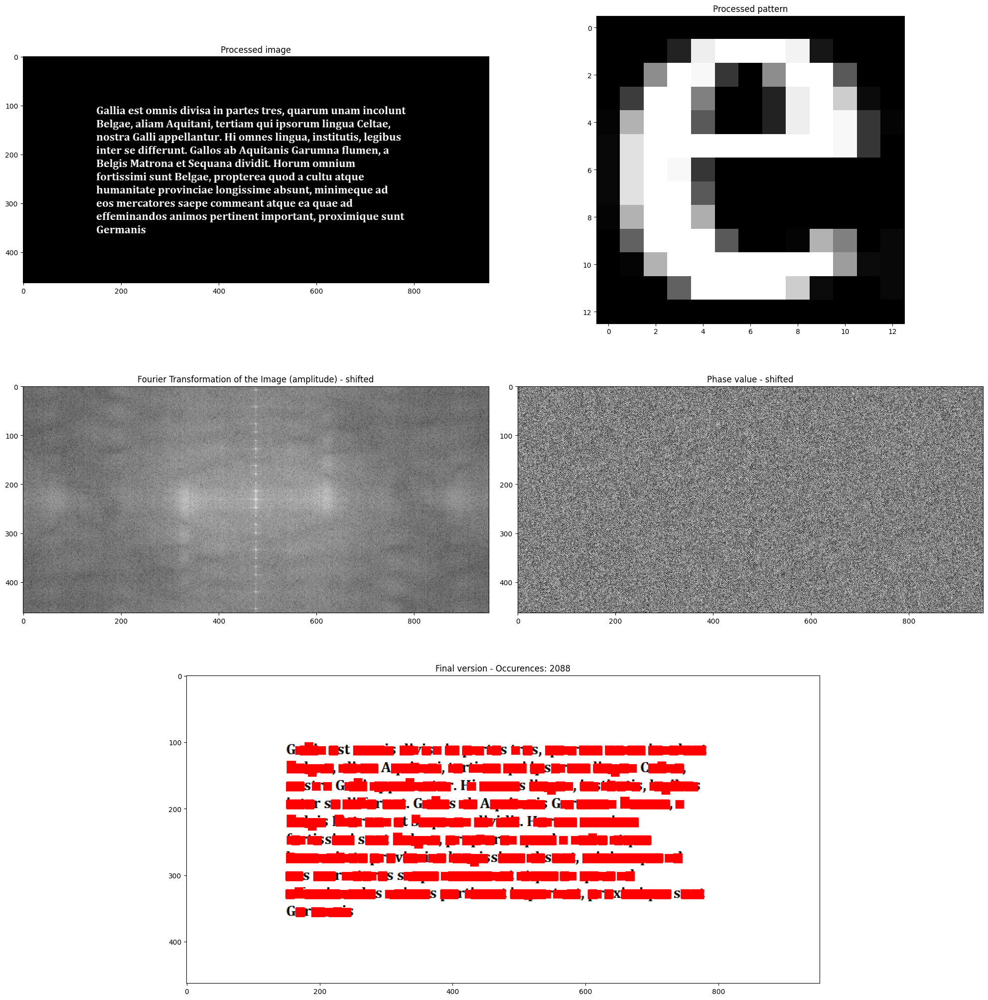

In [11]:
image_analysis("galia.png", "galia_e.png", 0.7, False)

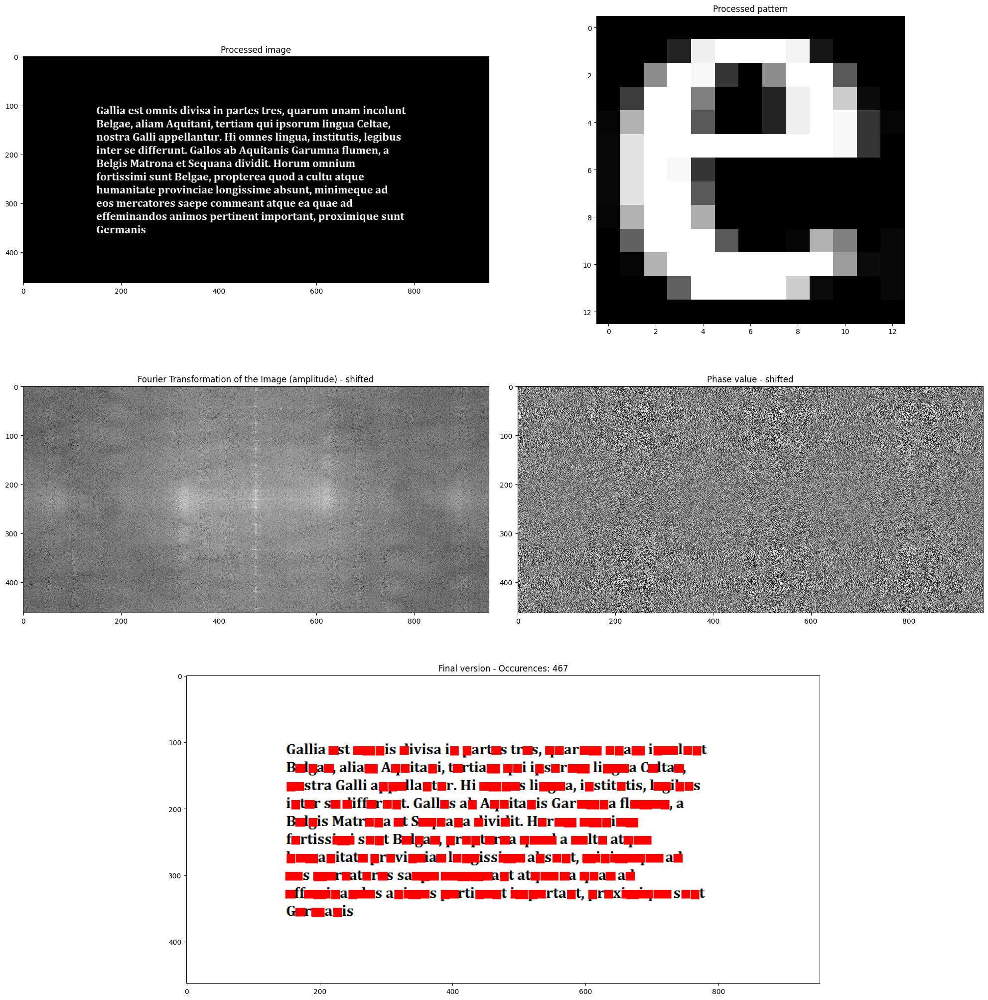

In [12]:
image_analysis("galia.png", "galia_e.png", 0.8, False)

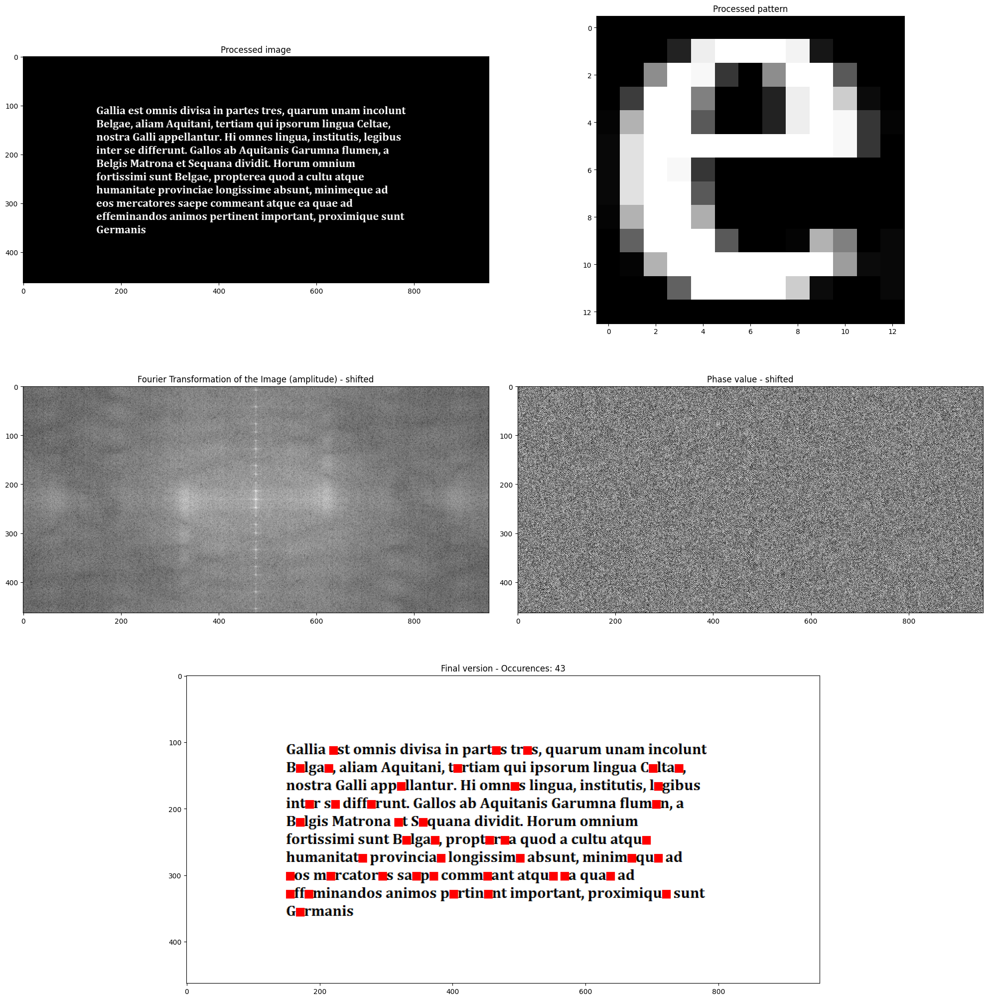

In [13]:
image_analysis("galia.png", "galia_e.png", 0.95, False)

Wnioski:
- dla tekstu i literki "e" algortym zwraca poprwaną liczbę wystąpień

## OCR

In [282]:
def load_characters(character_list, font_file, font_size):
    char_dict = {}
    font = ImageFont.truetype(font_file, font_size)

    for character in character_list:
        
        char_width, char_height = font.getsize(character)
        im = Image.new('L', (char_width, char_height), color='black')
        ImageDraw.Draw(im).text((0, 0), character, font=font, fill='white')
        np_array = np.array(im)
        # _, np_array = cv2.threshold(np_array, 0.0, 255.0, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
        char_dict[character] = np_array
    # to debug
    # im.save("a.png")
    cv2.imwrite("a.png", np_array)
    return char_dict

In [370]:
char_dict = load_characters("a", "Arial.ttf", 40)

In [276]:
def rotate(img, theta):
    rows, cols = img.shape[0], img.shape[1]
    image_center = (cols/2, rows/2)
    
    M = cv2.getRotationMatrix2D(image_center,theta,1)

    abs_cos = abs(M[0,0])
    abs_sin = abs(M[0,1])

    bound_w = int(rows * abs_sin + cols * abs_cos)
    bound_h = int(rows * abs_cos + cols * abs_sin)

    M[0, 2] += bound_w/2 - image_center[0]
    M[1, 2] += bound_h/2 - image_center[1]

    rotated = cv2.warpAffine(img,M,(bound_w,bound_h),borderValue=(255,255,255))
    return rotated

In [281]:
def process_image(image):
    img = cv2.imread(image)
    textImg = img.copy()

    gray_img = cv2.cvtColor(textImg, cv2.COLOR_RGBA2GRAY)
    gray_img = cv2.bitwise_not(gray_img)
    _, threshold_image = cv2.threshold(gray_img, 0.0, 255.0, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

    shape_points = np.argwhere(threshold_image > 0 )
    # https://theailearner.com/tag/cv2-minarearect/
    angle = cv2.minAreaRect(shape_points)[-1]
    print(angle)
    angle = -angle if angle < 45 else -(90 - angle)

    new_img = rotate(threshold_image, -angle)

    #Threshhold the image to denoise
    _, threshold_image = cv2.threshold(new_img, 0.0, 255.0, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

    cv2.imwrite("starry_night.png", threshold_image)
    return threshold_image

In [364]:
# process_image("image_1.png")
process_image("witaj_processed_Arial_40.png")
# process_image("starry_night.png")

90.0


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [9]:
def generate_image_from_text(text_filename, font_style, font_size=14, offset=10, chars_in_line = 30, rotate_angle = 0):
    font = ImageFont.truetype(font_style, size = font_size)

    with open(text_filename) as f:
        text_lines = f.readlines()
    
    wrapped_text = []
    processed_text = ""
    # print(len(text_lines))
    for line in text_lines:
        if line == '\n':
            wrapped_text.append('')
            continue
        wrapped_text.extend(textwrap.wrap(line, width=chars_in_line, break_long_words=False))
    # print(wrapped_text)
    for line in wrapped_text:
        processed_text += '{}\n'.format(line)
    # print(processed_text)

    page_width, page_heigh = font.getsize_multiline(processed_text)
    page_width += (2 * offset)
    page_heigh += (2 * offset)

    img = Image.new('RGBA', (page_width, page_heigh), color = "white")
    ImageDraw.Draw(img).text((offset, offset), processed_text, font=font, fill="black")
    

    img = img.rotate(rotate_angle, expand = 1)
    fff = Image.new('RGBA', img.size, color="white")

    img = Image.composite(img, fff, img)


    font_style_str = font_style.split(".")[0]
    text_filename_str = text_filename.split(".")[0]
    
    img.save("{}_processed_{}_{}.png".format(text_filename_str, font_style_str, font_size))
    img.show()
    
    

In [127]:
generate_image_from_text("text_filename.txt", "Arial.ttf",font_size=30 ,chars_in_line=100, rotate_angle = 0)

In [164]:
def get_line(coords, letter_h, idx, prev_y, start_x, blank_space):
    curr_y = coords[idx][2][0]
    # print("curr_y: ", curr_y)
    num_of_new_lines = ((curr_y - prev_y) // letter_h) - 1
    n = len(coords)
    half_h = letter_h
    
    line = list()
    counter = idx
    text = ""

    for i in range(num_of_new_lines):
        text += '\n'

    for i in range(idx, n):
        if abs(coords[i][2][0] - curr_y) > half_h:
            break
        line.append((coords[i][2], coords[i][1]))
        counter += 1 # when we want to start next get_line function -> idx
    
    line.sort(key = lambda x: x[0][1])
    # print("line: ", line)

    curr_x = line[0][0][1]

    start_letter = (curr_x - start_x) // blank_space
    for i in range(start_letter):
        text += " "
    
    

    for char in line:
        # print(char)
        if abs(char[0][1] - curr_x) > blank_space:
            spaces = (char[0][1] - curr_x) // blank_space
            # print(spaces)
            for i in range(spaces):
                text += " "
        
        text += char[1]
        curr_x = char[0][1]
    text += '\n'
    return text, counter, curr_y

In [167]:
def convert_coords_to_text(coords, letter_h, blank_space):
    # get_line(coords, letter_h, idx, prev_y, start_x, blank_space)
    i = 0
    text = ""
    curr_y = 0

    # start x
    start_x = min(coords, key = lambda x: x[2][1])[2][1]
    # print(start_x)
    
    coords = sorted(coords, key = lambda x: x[2][0])

    while i < len(coords):
        line, i, curr_y = get_line(coords, letter_h, i, curr_y, start_x, blank_space)
        text += line
    print(text)
    return text

In [212]:
def select_letters(matrix_of_coords, characters):
    for i in range(len(matrix_of_coords)): # rows
        for j in range(len(matrix_of_coords[0])): # columns
            if matrix_of_coords[i][j] != 0:
                letter = matrix_of_coords[i][j][1]

                letter_h, letter_w = characters[letter].shape
                for k in range(i, i-letter_h, -1): # checking width
                # for k in range(i - letter_h//2, i+letter_h//2): # checking width
                    for l in range(j, j-letter_w, -1): # checking heigh
                    # for l in range(j-letter_w//2, j+letter_w//2): # checking heigh
                        if (k != i or l != j) and  len(matrix_of_coords)> l > 0 and\
                             len(matrix_of_coords[0]) > k > 0 and matrix_of_coords[k][l] != 0:
                            if matrix_of_coords[k][l][0] > matrix_of_coords[i][j][0]:
                                matrix_of_coords[i][j] = matrix_of_coords[k][l]
                            matrix_of_coords[k][l] = 0
    return matrix_of_coords


In [221]:
def get_text(chars_by_cords, blank_width, loaded_characters):
    text = ''
    for y_cord in sorted(chars_by_cords.keys()):
        prev_x = None
        for x_cord in sorted(chars_by_cords[y_cord].keys()):
            char_from_img = chars_by_cords[y_cord][x_cord]
            curr_x = char_from_img[1][0]
            msg = char_from_img[0]
            if prev_x is not None and curr_x - prev_x >= blank_width:
                msg = f' {msg}'

            text += msg
            prev_x = curr_x + loaded_characters[char_from_img[0]].shape[1]

        text += '\n'

    return text

In [294]:
def ocr(image_path, font_file, font_size, param_C=0.95):
    letters = string.ascii_lowercase + "?!"
    loaded_characters = load_characters(letters, font_file, font_size)
    space = load_characters(" ", font_file, font_size)[" "]
    img = process_image(image_path)
    # like basicaly img_w is height of the image ang img_h is width of the image XD
    img_h, img_w = img.shape
    print(img_w, img_h)
    inv_img = np.swapaxes(img, 0, 1)
    letter_coords = [[0 for _ in range(img_h)] for _ in range(img_w)]
    min_letter_h = float("inf")

    # dft = np.fft.fft2(img)
    dft = np.fft.fft2(inv_img)

    # ALERT
    caught_chars = []
    char_height, char_width = loaded_characters["l"].shape
    print("char_width, char_height ", char_width, char_height)
    C_epsilon = 1e-5

    for letter in letters:
        letter_w, letter_h = loaded_characters[letter].shape
        inv_letter = np.swapaxes(loaded_characters[letter], 0, 1)
        # print(letter_w, letter_h)
        min_letter_h = min_letter_h if letter_h > min_letter_h else letter_w
        # C = np.real(np.fft.ifft2(np.multiply(dft, np.fft.fft2(np.rot90(inv_letter, 2), s = (img_w, img_h)))))
        # max_C = np.amax(C)

        max_C = np.max(np.real(np.fft.ifft2(np.fft.fft2(inv_letter) * np.fft.fft2(np.rot90(inv_letter, k=2)))))
        C = np.abs(np.real(np.fft.ifft2(dft * np.fft.fft2(np.rot90(inv_letter, k=2), s=[img_w, img_h]))))
        

        for x in range(img_w):
            for y in range(img_h):
                # if C[x, y] >= param_C * max_C:
                if C[x][y] > max_C - 1000:
                    caught_chars.append([letter, (x - char_width + 1, y - char_height + 1), C[x,y]])
                    if letter_coords[x][y] == 0 or letter_coords[x][y][0] < C[x, y]:
                        letter_coords[x][y] = [C[x,y], letter, (x, y)]
        # every time we want to delete letters that are included in "higher score" 
        # convolution of letters are appearing in lower right corner
        letter_coords = select_letters(letter_coords, loaded_characters)
        
    
    # for letter_arr in letter_coords:
        # print(letter_arr)
    # print(letter_coords)
    matrix_coords = np.array(letter_coords)
    matrix_coords = matrix_coords[matrix_coords != 0]


    chars_by_cords = defaultdict(dict)
    for caught_char in caught_chars:
        x_cord, y_cord = caught_char[1][0] // char_width, caught_char[1][1] // char_height
        if y_cord not in chars_by_cords or x_cord not in chars_by_cords[y_cord] or caught_char[2] > chars_by_cords[y_cord][x_cord][2]:
            chars_by_cords[y_cord][x_cord] = caught_char


    # convert_coords_to_text(coords, letter_h, blank_space)
    print("shape: ", space.shape)
    text = get_text(chars_by_cords, space.shape[1], loaded_characters)
    print(text)
    # CORRECT text = convert_coords_to_text(matrix_coords, min_letter_h, int(space.shape[0]))


    # text = convert_coords_to_text(matrix_coords, min_letter_h, 31)
    # print(matrix_coords[0])
    # print(matrix_coords)



In [288]:
CHARS = 'abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789.,?!'
UpperLeft = namedtuple('UpperLeft', ['x', 'y'])
ImageChar = namedtuple('ImageChar', ['char_repr', 'UpperLeft', 'C'])
CharShape = namedtuple('CharShape', ['width', 'height'])



def process_img_1(img, extra_val_tranform=None): #img is result of Image.open()
    gray_scale = img.convert('L')
    inverted = ImageOps.invert(gray_scale)
    transformed = np.abs(np.array(inverted) - extra_val_tranform) if extra_val_tranform is not None else np.array(inverted)
    return img, np.swapaxes(transformed, 0, 1)

def get_text_1(chars_by_cords, blank_width, shapes_by_chars):
    text = ''
    for y_cord in sorted(chars_by_cords.keys()):
        prev_x = None
        for x_cord in sorted(chars_by_cords[y_cord].keys()):
            char_from_img = chars_by_cords[y_cord][x_cord]
            curr_x = char_from_img.UpperLeft.x
            msg = char_from_img.char_repr
            if prev_x is not None and curr_x - prev_x >= blank_width:
                msg = f' {msg}'

            text += msg
            prev_x = curr_x + shapes_by_chars[char_from_img.char_repr].width

        text += '\n'

    return text

def ocr_1(image_path, font_path):
    img = Image.open(image_path)
    img_width, img_height = img.size
    print(img_width, img_height)
    _, im_processed = process_img_1(img)
    dft = np.fft.fft2(im_processed)

    font = ImageFont.truetype(font_path, 40)
    char_width, char_height = font.getsize('l')
    print(char_width, char_height)
    blank_width, _ = font.getsize(' ')
    print(blank_width)

    caught_chars = list()
    shapes_by_chars = dict()
    C_epsilon = 1e-5
    for char in CHARS:
        char_width, char_height = font.getsize(char)
        shapes_by_chars[char] = CharShape(char_width, char_height)
        letter = Image.new('RGB', (char_width, char_height), color='white')
        ImageDraw.Draw(letter).text((0, 0), char, font=font, fill='black')
        _, letter_processed = process_img_1(letter)

        max_letter_C = np.max(np.real(np.fft.ifft2(np.fft.fft2(letter_processed) * np.fft.fft2(np.rot90(letter_processed, k=2)))))
        C = np.abs(np.real(np.fft.ifft2(dft * np.fft.fft2(np.rot90(letter_processed, k=2), s=[img_width, img_height]))) / max_letter_C - 1)
        for x in range(img_width):
            for y in range(img_height):
                if C[x][y] < C_epsilon:
                    caught_chars.append(ImageChar(char,  UpperLeft(x - char_width + 1, y - char_height + 1), C[x][y]))

    chars_by_cords = defaultdict(dict)
    for caught_char in caught_chars:
        x_cord, y_cord = caught_char.UpperLeft.x // char_width, caught_char.UpperLeft.y // char_height
        if y_cord not in chars_by_cords or x_cord not in chars_by_cords[y_cord] or caught_char.C < chars_by_cords[y_cord][x_cord].C:
            chars_by_cords[y_cord][x_cord] = caught_char

    print(get_text_1(chars_by_cords, blank_width, shapes_by_chars))

In [280]:
ocr_1("witaj_processed_Arial_40.png", "Arial.ttf")

113 221
9 37
11
12519820.0
13060127.0
8949489.0
13101151.999999998
12067429.000000004
8135373.0
15614085.0
11848952.000000002
5118874.999999999
7013275.999999999
11749072.0
6032551.0
15573678.999999998
10169257.000000004
10769001.0
13095329.0
13002399.999999998
5644968.0
10426933.0
7169630.0
10033760.0
8090941.0
14756273.000000002
9776616.0
10380247.0
10426611.0
15350489.0
21815305.0
15411381.0
19472731.999999996
19793189.999999996
14092311.0
19329141.0
17306250.0
6296567.0
9568868.0
16326280.999999994
10332175.000000004
22675037.999999996
19199750.000000004
18270320.0
16870040.0
20290655.0
20883808.0
16837649.0
11387683.0
15413528.000000002
12284333.0
21911639.000000004
14519344.0
10972558.0
16959405.0
14682515.0
7573726.0
14196029.0
12895132.0
13162144.0
15259885.0
16411064.0
10344572.000000002
16851553.0
16280390.0
921740.0000000002
1506159.0
8689232.0
5602218.000000002
twoja
stara
sra d
gara



In [240]:
generate_image_from_text("witaj.txt", "Arial.ttf",font_size=40 ,chars_in_line=100, rotate_angle =0)

In [398]:
process_image("witaj_processed_Arial_40.png")

90.0


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [295]:
ocr("witaj_processed_Arial_40.png", "Arial.ttf", 40, 0.9999)

90.0
113 221
char_width, char_height  9 37
shape:  (37, 11)
t wcoa
st a a
s acd
ga a



/tmp/ipykernel_6825/3482536545.py:49: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  matrix_coords = np.array(letter_coords)
